<div class="usecase-title">Night-time Saftey Index</div>

<div class="usecase-authors"><b>Authored by: Adithya Sentil</b> </div>

<div class="usecase-duration"><b>Duration:</b> 90 mins</div>

<div class="usecase-level-skill">
    <div class="usecase-level"><b>Level: </b>Intermediate</div>
    <div class="usecase-skill"><b>Pre-requisite Skills: </b>Python</div>
</div>

<header>
<h2>Scenario</h2>
<div> Melbourne is a vibrnt city with a 24h economy, as of a result transport authorities, city planners and concerned community members are increasingly worried about the night time saftey of the city. While melbourne has a thriving culture with many events, hospitality, shopping and public transport running late into the night. Not all parts of Melbourne is safe with the increased number of inccidents of crime occuring in city particularly in isolated walkways and streets with poor lighting. This raises concern in the community for the youth, elderly, women, students and shift workers alike. To address this problem, I have used the data from City of Melbourne open datasets. The implemented datasets include: 
- Street lighting 
- Pedestrian foot traffic 
- Public Transport stop locations. 

By developing the Night time saftey Index, I aim to identify areas within melbourne that are considered high risk zones. Areas in which there is low visibility, little to no street lights, little foot traffic and is not near a public transport stop. Conversly areas will be mared as safer if there is higher visibility, more foot traffic as this acts as a percieved layer of saftey  and access to public transport, as generally the likleyhood of people would be higher. The index is developed based on understanding crime data on low light and low populas areas. 

With the use of the Night-time saftey index, we can strive to improve these areas improve the saftey index and build a more safe and inclusive city for all members of the community.  </div>

{As a student who commutes to the city regularly for work and univesity, I end up often traveling after dark. I want to know which areas in melbourne are safe or dangerous at night. So that I can plan a safer routes, avoid areas that are dangerous and feel confident that I will be safe moving through the city at night.}

<div class="usecase-section-header">What this use case will teach you</div>

At the end of this use case you will:
- Demonstraite the ability to retrieve and process data from public API
- Data cleaning and preprocessing techniques on geospatial and time data
- Perform basic aggregation and filtering methods 
- Perform analysis using latitude and longitude data
- Implement data visualisation techniques 

## Introduction 
This use case aims to develop a Night time saftey index by combining datasets from the City of Melbourne Open data project. By combing the data, it can be then assessed and visualised to demonstrate the varying saftey level for different areas during the night hours. The project goal is to disover areas with low visablity, low foot traffic or infrastructure to aid in future developmenet to create a safer melbourne for all. The analysis is drawn from the datasets below accessed via the Melbourne open data API. By combining combining these datasets the project aims to create a data driven solution to create a safer and inclusive city.

Dataset Links 
- Bus Stops data link: https://data.melbourne.vic.gov.au/explore/dataset/bus-stops/api/  
- Street Lighting data link: https://data.melbourne.vic.gov.au/explore/dataset/street-lights-with-emitted-lux-level-council-owned-lights-only/api/
- Pedestrian counting link: https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-counting-system-monthly-counts-per-hour/api/
- Feautured light data link: https://data.melbourne.vic.gov.au/explore/dataset/feature-lighting-including-light-type-wattage-and-location/api/


### Importing Required Libraries

In [10]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import requests
import os

### Importing Datasets 
Importing Dataset using API v2.1

In [6]:
os.environ['MELBOURNE_API_KEY'] = '8078dfb7bf8c828e3a48aacab82c64557925032c294a7ee21f6ab0d2'


In [7]:

def fetch_data(base_url, dataset, api_key, num_records=99, offset=0):
    all_records = []
    max_offset = 9900  # Maximum number of requests

    while True:
        # Maximum limit check
        if offset > max_offset:
            break

        # Create API request URL
        filters = f'{dataset}/records?limit={num_records}&offset={offset}'
        url = f'{base_url}{filters}&api_key={api_key}'

        # Start request
        try:
            result = requests.get(url, timeout=10)
            result.raise_for_status()
            records = result.json().get('results')
        except requests.exceptions.RequestException as e:
            raise Exception(f"API request failed: {e}")
        if records is None:
            break
        all_records.extend(records)
        if len(records) < num_records:
            break

        # Next cycle offset
        offset += num_records

    # DataFrame all data
    df = pd.DataFrame(all_records)
    return df



# Retrieve API key from environment variable
API_KEY = os.environ.get('MELBOURNE_API_KEY')
BASE_URL = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'

### Importing Council Owned Street light data 
Several key tasks are completed to prepare the street light dataset for future analysis. Firstly the Dataset is retrieved the dataset is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the geo_point_2d row stores the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from geo_point_2d. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if geo_point_2d is a valid dcitionary. 
Finally a prieview of the code is created with .head() 

In [ ]:
# Data set name
dataset_street_lighting = 'street-lights-with-emitted-lux-level-council-owned-lights-only'

street_light_df = fetch_data(BASE_URL, dataset_street_lighting, API_KEY)
#Create a new col longitude 
street_light_df['longitude'] = street_light_df['geo_point_2d'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)
#Create a new col latitude 
street_light_df['latitude'] = street_light_df['geo_point_2d'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)

# Filter and display rows where geo_point_2d is NOT a dictionary
invalid_geo_rows = street_light_df[~street_light_df['geo_point_2d'].apply(lambda x: isinstance(x, dict))]

# Display 
print(invalid_geo_rows[['geo_point_2d']])
street_light_df.head()


Empty DataFrame
Columns: [geo_point_2d]
Index: []


,geo_point_2d,geo_shape,prop_id,name,addresspt1,xorg,ext_id,asset_clas,label,asset_type,...,addresspt,asset_subt,xsource,profile,xdate,xdrawing,mcc_id,roadseg_id,longitude,latitude
0,"{'lon': 144.98066700010136, 'lat': -37.8116730...","{'type': 'Feature', 'geometry': {'coordinates'...",0,None,0.0,ESG,35350,None,0.684,None,...,0,None,None,None,20140916,None,0,0,144.980667,-37.811673
1,"{'lon': 144.9806740000221, 'lat': -37.81162799...","{'type': 'Feature', 'geometry': {'coordinates'...",0,None,0.0,ESG,35364,None,0.196,None,...,0,None,None,None,20140916,None,0,0,144.980674,-37.811628
2,"{'lon': 144.9807329998954, 'lat': -37.81139499...","{'type': 'Feature', 'geometry': {'coordinates'...",0,None,0.0,ESG,35436,None,3.715,None,...,0,None,None,None,20140916,None,0,0,144.980733,-37.811395
3,"{'lon': 144.98073799991442, 'lat': -37.8113810...","{'type': 'Feature', 'geometry': {'coordinates'...",0,None,0.0,ESG,35440,None,2.835,None,...,0,None,None,None,20140916,None,0,0,144.980738,-37.811381
4,"{'lon': 144.9785690000381, 'lat': -37.81117199...","{'type': 'Feature', 'geometry': {'coordinates'...",0,None,0.0,ESG,36934,None,3.03,None,...,0,None,None,None,20140916,None,0,0,144.978569,-37.811172


### Importing feature light data 
The data is fetched using the API and then the rows are renamed to latitude and longitude to keep consistant nameing porfile throughout all datasets.Enabling seamless geospatial analysis and integration with other location-based data 


In [14]:
# Data set name
feature_light_data = 'feature-lighting-including-light-type-wattage-and-location'
#Fetch data 
feature_light_df = fetch_data(BASE_URL, feature_light_data, API_KEY)
#Rename columns latitude and longitude 
feature_light_df.rename(columns={"lat": "latitude", "lon": "longitude"}, inplace= True)
print("Missing values per column:")
print(feature_light_df.isnull().sum())
feature_light_df.head()
feature_light_df.describe()


Missing values per column:
asset_number                 0
asset_description            0
lamp_type_lupvalue        1093
lamp_rating_w             4458
mounting_type_lupvalue     611
latitude                     0
longitude                    0
location                     0
dtype: int64


,asset_number,lamp_type_lupvalue,lamp_rating_w,latitude,longitude
count,8.564000e+03,7471.000000,4106.000000,8564.000000,8564.000000
mean,1.492630e+06,8.017401,52.039211,-37.818159,144.952375
std,8.554725e+04,4.428364,53.874435,0.006589,0.011364
min,1.346354e+06,1.000000,3.000000,-37.844649,144.921921
25%,1.487632e+06,3.000000,14.000000,-37.822813,144.944251
50%,1.540754e+06,9.000000,36.000000,-37.819194,144.947282
75%,1.542894e+06,13.000000,70.000000,-37.815231,144.963851
max,1.771404e+06,16.000000,500.000000,-37.786462,144.985432


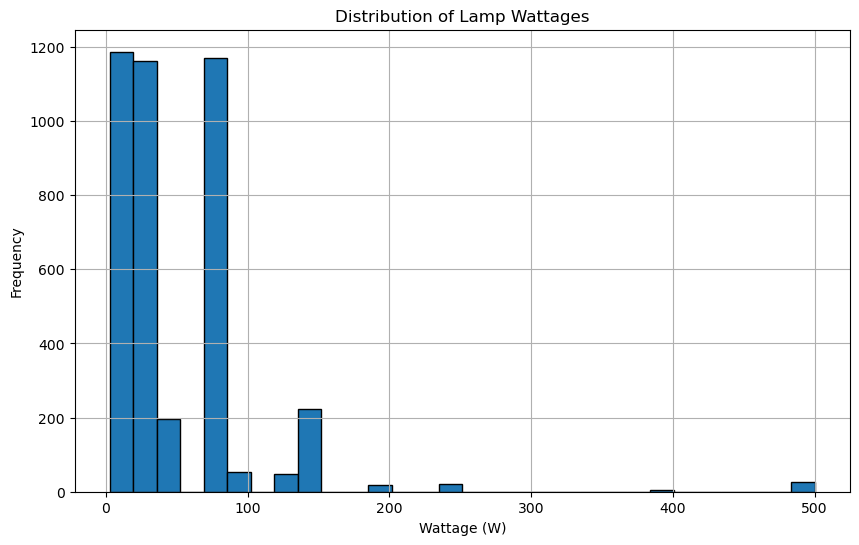

In [16]:

plt.figure(figsize=(10,6))
plt.hist(feature_light_df['lamp_rating_w'].dropna(), bins=30, edgecolor='black')
plt.title('Distribution of Lamp Wattages')
plt.xlabel('Wattage (W)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

No missing values from Longitude or Latitude 

### Importing Pedestrian Counting data 
Several key tasks are completed to prepare the Pedestrian counting dataset for future analysis. Firstly the Dataset is retrieved the dataset is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the geo_point_2d row stores the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from geo_point_2d. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if geo_point_2d is a valid dcitionary. 
Finally a prieview of the code is created with .head() 


In [36]:
# Data set name
dataset_pedestrian_counting = 'pedestrian-counting-system-monthly-counts-per-hour'
# Fetch dataset 
pedestrian_counting_df = fetch_data(BASE_URL, dataset_pedestrian_counting, API_KEY)
# Create a new row named latitude
pedestrian_counting_df['latitude'] = pedestrian_counting_df['location'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)
# Create a new row named longitude
pedestrian_counting_df['longitude'] = pedestrian_counting_df['location'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)
pedestrian_counting_df.head()

,id,location_id,sensing_date,hourday,direction_1,direction_2,pedestriancount,sensor_name,location,latitude,longitude
0,47320241113,47,2024-11-13,3,27,9,36,Eli250_T,"{'lon': 144.9625775, 'lat': -37.81258467}",-37.812585,144.962578
1,24320240608,24,2024-06-08,3,49,34,83,Col620_T,"{'lon': 144.95449198, 'lat': -37.81887963}",-37.818880,144.954492
2,162520241119,162,2024-11-19,5,14,10,24,Eli489_T,"{'lon': 144.95987909, 'lat': -37.80740397}",-37.807404,144.959879
3,481620240302,48,2024-03-02,16,436,194,630,QVMQ_T,"{'lon': 144.95866697, 'lat': -37.80631581}",-37.806316,144.958667
4,134920231016,134,2023-10-16,9,182,224,406,Spen201_T,"{'lon': 144.95303935, 'lat': -37.81694221}",-37.816942,144.953039


### Exploritory Pedestrian Activity Patterns
The data is investigated to develop a better understanding on the data and to build better insights into the statistics. To understand the foot traffic across Melbourne at various points in the day, I analyse the Pedestrian counting system dataset, the sensor provides hourly pedestrain counts caputed through sensors placed in various locations throughout the city. The first step that is carried out is the maximum and minimum pedestrian volumes. This allows me to identify the busiest and the quietest recored counts, including their exact location and hour of the day the data was collected. 
date_time is a sorted time seried by sensing_date, hourday and location_id to allow for time trend analysis which time are busier and which are not. 
Finally the data is grouped by sensor_name, sensing_date and hourday to be implemented in more advance data aggregation. 


In [28]:

max_count = pedestrian_counting_df['pedestriancount'].max() 
min_count = pedestrian_counting_df['pedestriancount'].min()  
busiest_loc = pedestrian_counting_df.loc[pedestrian_counting_df['pedestriancount'].idxmax()][['latitude', 'longitude', 'hourday']]
quietest_loc = pedestrian_counting_df.loc[pedestrian_counting_df['pedestriancount'].idxmin()][['latitude', 'longitude', 'hourday']]
date_time = pedestrian_counting_df.sort_values(['sensing_date', 'hourday', 'location_id'])
group_ped_data = pedestrian_counting_df.groupby(['sensor_name', 'sensing_date', 'hourday'])
print(pedestrian_counting_df.info()) 
print(date_time)

print(max_count)
print(min_count)
print(busiest_loc)
print(quietest_loc)



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9999 entries, 0 to 9998
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               9999 non-null   int64  
 1   location_id      9999 non-null   int64  
 2   sensing_date     9999 non-null   object 
 3   hourday          9999 non-null   int64  
 4   direction_1      9999 non-null   int64  
 5   direction_2      9999 non-null   int64  
 6   pedestriancount  9999 non-null   int64  
 7   sensor_name      9999 non-null   object 
 8   location         9999 non-null   object 
 9   latitude         9999 non-null   float64
 10  longitude        9999 non-null   float64
dtypes: float64(2), int64(6), object(3)
memory usage: 859.4+ KB
None
                 id  location_id sensing_date  hourday  direction_1  \
9906    10320210701           10   2021-07-01        3            1   
4867    40420210701           40   2021-07-01        4            1   
5506    48520

### Importing bus stop data 
Several key tasks are completed to prepare the bus stop dataset for future analysis. Firstly the Dataset is retrieved the dataset is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the geo_point_2d row stores the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from geo_point_2d. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if geo_point_2d is a valid dcitionary. 
Finally a prieview of the code is created with .head() 

In [8]:
# Data set names
dataset_bus_stops = 'bus-stops'
# Fetch dataset 
bus_stops_df = fetch_data(BASE_URL, dataset_bus_stops, API_KEY)
# Create a new row named latitude
bus_stops_df['latitude'] = bus_stops_df['geo_point_2d'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)
# Create a new row name longitude 
bus_stops_df['longitude'] = bus_stops_df['geo_point_2d'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)
bus_stops_df.head()

,geo_point_2d,geo_shape,prop_id,addresspt1,addressp_1,asset_clas,asset_type,objectid,str_id,addresspt,asset_subt,model_desc,mcc_id,roadseg_id,descriptio,model_no,latitude,longitude
0,"{'lon': 144.96889648633675, 'lat': -37.8184248...","{'type': 'Feature', 'geometry': {'coordinates'...",573333,29.149053,288,Signage,Sign - Public Transport,749,1249454,606816,None,Sign - Public Transport 1 Panel,1249454,0,Sign - Public Transport 1 Panel Bus Stop Type 12,P.16,-37.818425,144.968896
1,"{'lon': 144.95888238475013, 'lat': -37.8176759...","{'type': 'Feature', 'geometry': {'coordinates'...",0,10.537902,105,Signage,Sign - Public Transport,2098,1247042,507646,None,Sign - Public Transport 1 Panel,1247042,20118,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16,-37.817676,144.958882
2,"{'lon': 144.95963193312105, 'lat': -37.7818891...","{'type': 'Feature', 'geometry': {'coordinates'...",0,25.269643,212,Signage,Sign - Public Transport,2143,1252383,108510,None,Sign - Public Transport 1 Panel,1252383,22387,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16,-37.781889,144.959632
3,"{'lon': 144.94716743007305, 'lat': -37.7937265...","{'type': 'Feature', 'geometry': {'coordinates'...",0,44.230506,237,Signage,Sign - Public Transport,2627,1249788,100087,None,Sign - Public Transport 1 Panel,1249788,20919,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16,-37.793727,144.947167
4,"{'lon': 144.92778487963457, 'lat': -37.8028616...","{'type': 'Feature', 'geometry': {'coordinates'...",0,67.718553,360,Signage,Sign - Public Transport,3306,1235311,103002,None,Sign - Public Transport 1 Panel,1235311,21680,Sign - Public Transport 1 Panel Bus Stop Type 13,P.16,-37.802862,144.927785


### Visualising Dataset using folium 
I have iterated through each of the datasets and coloured the elements respectfully blue: bus stops, red: pedestrian count sensor location, yellow: street lights. This provides a visual guid to understand the location of each of the street lights, location of each of the bus stops and the location of each of the pedestrain sensors with this informaiton we can get a better understanding on how to further progress on the project what data is scarse and what areas need more data sources to produce reliable information. 

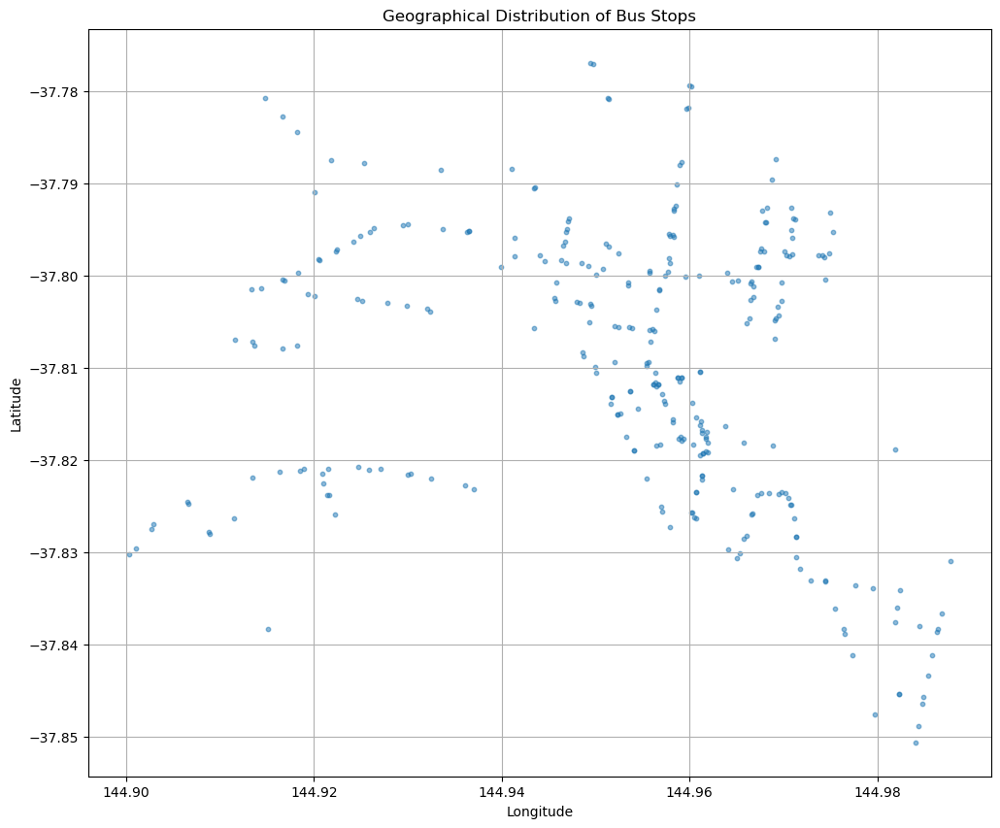

In [13]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 10))
plt.scatter(bus_stops_df['longitude'],bus_stops_df['latitude'], alpha=0.5, s=10)
plt.title('Geographical Distribution of Bus Stops')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()


In [31]:
import folium
from folium.plugins import HeatMap 

# Center map on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=13)

# Add markers from the dataset bus_stops_df
for _, row in bus_stops_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=2,
            color='blue',
            fill=True
        ).add_to(m)

# Add markers from the dataset pedestrian_counting_df
for _, row in pedestrian_counting_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=3,
            color='red',
            fill=True
        ).add_to(m)

# Add markers from the dataset street_lighting_df
for _, row in street_light_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=2,
            color='yellow',
            fill=True
        ).add_to(m)

# Add markers from the dataset feature_light_df
print(f"Total number of street lights plotted: {count}")
for _, row in feature_light_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=2,
            color='yellow',
            fill=True
        ).add_to(m)

m



Total number of street lights plotted: 9999


The output produced is a Map of the melbourne CBD with yelow dots for the street light location, blue dots for the bus stop location and red dot for the pedestrain count locations. As seen by this map we can identify some key areas the light pattern is not uniform throughout the city we can see that it is concentrated more in certain areas and not present in others. Furthermore, we can see that the pedestrain sensor is also only in specific locations around the city hence the data will need to be extrapolated for the locations that are missing the street light map will have to be normalised to exist in areas that it isnt present. However visualising the data has presented quite usefull as it produces a greater grasp of each of the datasets and what we need to to complete the task accuratly to ensure the Night time saftey index is correct. 